<a href="https://colab.research.google.com/github/SSR-ds/Time-Series-with-Python/blob/main/Deep_Learning_TS_Model_using_Deep_AR_Multivariate_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install --upgrade mxnet==1.6.0
!pip install gluonts

     |████████████████████████████████| 68.7MB 54kB/s 
  Found existing installation: graphviz 0.10.1
    Uninstalling graphviz-0.10.1:
      Successfully uninstalled graphviz-0.10.1
     |████████████████████████████████| 573kB 3.6MB/s 
     |████████████████████████████████| 8.7MB 16.4MB/s 
     |████████████████████████████████| 194kB 46.5MB/s 
  Created wheel for ujson: filename=ujson-1.35-cp36-cp36m-linux_x86_64.whl size=68011 sha256=5453c86b8aca600fdba5b03f6bfbea0532d0475176c9c01ea944f0f5f9365fca
  Stored in directory: /root/.cache/pip/wheels/28/77/e4/0311145b9c2e2f01470e744855131f9e34d6919687550f87d1
Successfully built ujson


In [2]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import matplotlib as mpl
import plotly.express as px
%matplotlib inline

import os
from keras.preprocessing.sequence import TimeseriesGenerator
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from IPython.display import Image, display 


from gluonts.model.deepar import DeepAREstimator
from gluonts.trainer import Trainer

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

from datetime import datetime
import seaborn as sns   

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: DeprecationWarning:

gluonts.trainer is deprecated. Use gluonts.mx.trainer instead.



In [3]:
from google.colab import files
uploaded = files.upload()

Saving energydata_complete.csv to energydata_complete.csv


In [4]:
df1 = pd.read_csv('energydata_complete.csv')

In [5]:
df1.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,18.2,48.863333,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.2,48.730000,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.1,48.590000,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,41.230000,18.1,48.590000,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [6]:
df1.dtypes

date            object
Appliances       int64
lights           int64
T1             float64
RH_1           float64
T2             float64
RH_2           float64
T3             float64
RH_3           float64
T4             float64
RH_4           float64
T5             float64
RH_5           float64
T6             float64
RH_6           float64
T7             float64
RH_7           float64
T8             float64
RH_8           float64
T9             float64
RH_9           float64
T_out          float64
Press_mm_hg    float64
RH_out         float64
Windspeed      float64
Visibility     float64
Tdewpoint      float64
rv1            float64
rv2            float64
dtype: object

In [7]:
df1['date'] = pd.to_datetime(df1['date'])

In [8]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   date         19735 non-null  datetime64[ns]
 1   Appliances   19735 non-null  int64         
 2   lights       19735 non-null  int64         
 3   T1           19735 non-null  float64       
 4   RH_1         19735 non-null  float64       
 5   T2           19735 non-null  float64       
 6   RH_2         19735 non-null  float64       
 7   T3           19735 non-null  float64       
 8   RH_3         19735 non-null  float64       
 9   T4           19735 non-null  float64       
 10  RH_4         19735 non-null  float64       
 11  T5           19735 non-null  float64       
 12  RH_5         19735 non-null  float64       
 13  T6           19735 non-null  float64       
 14  RH_6         19735 non-null  float64       
 15  T7           19735 non-null  float64       
 16  RH_7

In [9]:
df1= df1.set_index('date')

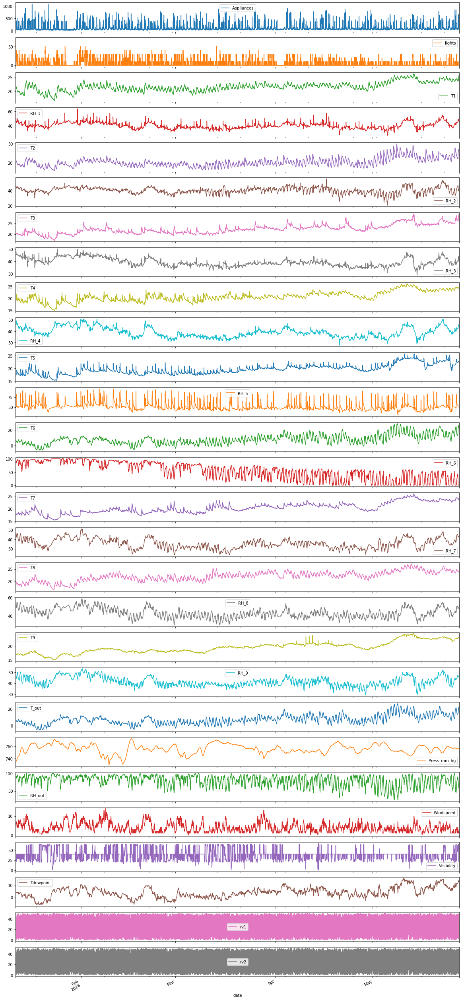

In [10]:
df1.plot(subplots=True,figsize=(20,50));

In [11]:
df1.columns

Index(['Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4',
       'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9',
       'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility',
       'Tdewpoint', 'rv1', 'rv2'],
      dtype='object')

In [12]:
df1.shape

(19735, 28)

In [13]:
df1.tail(737)

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-05-22 15:20:00,100,0,24.700000,52.163333,24.066667,51.290000,26.566667,45.230000,24.000000,49.966667,22.890000,54.764286,19.856667,37.866667,23.600000,47.525714,25.390000,52.900000,23.290000,51.090000,16.666667,750.200000,86.666667,3.000000,35.666667,14.466667,16.734822,16.734822
2016-05-22 15:30:00,110,0,24.700000,52.163333,24.066667,51.163333,26.500000,45.290000,24.100000,50.030000,22.890000,54.700000,20.133333,36.026667,23.600000,47.590000,25.500000,52.790000,23.290000,50.754000,16.550000,750.200000,87.500000,3.000000,33.500000,14.500000,24.102013,24.102013
2016-05-22 15:40:00,90,0,24.633333,52.200000,24.000000,51.163333,26.390000,45.400000,24.100000,50.163333,22.890000,54.700000,20.200000,33.893333,23.671429,47.684286,25.500000,52.751429,23.304286,50.624286,16.433333,750.200000,88.333333,3.000000,31.333333,14.533333,45.143141,45.143141
2016-05-22 15:50:00,90,0,24.700000,52.200000,24.033333,51.230000,26.390000,45.466667,24.133333,50.060000,22.890000,54.700000,20.630000,30.926667,23.620000,47.718000,25.520000,52.812000,23.330000,50.576000,16.316667,750.200000,89.166667,3.000000,29.166667,14.566667,32.513049,32.513049
2016-05-22 16:00:00,90,0,24.700000,52.163333,24.100000,51.230000,26.390000,45.590000,24.200000,49.933333,22.921429,54.621429,21.030000,28.200000,23.700000,47.790000,25.600000,52.971429,23.290000,50.764286,16.200000,750.200000,90.000000,3.000000,27.000000,14.600000,3.834628,3.834628
2016-05-22 16:10:00,80,0,24.700000,52.090000,24.230000,51.200000,26.323333,45.590000,24.200000,49.790000,22.890000,54.590000,21.200000,25.500000,23.700000,47.790000,25.640000,53.236000,23.350000,50.940000,16.250000,750.200000,90.000000,2.833333,29.166667,14.633333,26.775014,26.775014
2016-05-22 16:20:00,100,0,24.700000,52.090000,24.290000,51.126667,26.290000,45.590000,24.200000,49.790000,22.905714,54.590000,20.993333,24.566667,23.700000,47.884286,25.700000,53.454286,23.290000,51.056250,16.300000,750.200000,90.000000,2.666667,31.333333,14.666667,29.795743,29.795743
2016-05-22 16:30:00,90,0,24.700000,52.090000,24.290000,51.045000,26.290000,45.663333,24.200000,49.766667,22.956000,54.590000,20.790000,26.426667,23.700000,47.960000,25.718000,53.630000,23.290000,51.105714,16.350000,750.200000,90.000000,2.500000,33.500000,14.700000,23.589798,23.589798
2016-05-22 16:40:00,90,0,24.700000,51.966667,24.200000,50.900000,26.200000,45.626667,24.200000,49.966667,23.000000,54.590000,20.730000,27.033333,23.700000,48.000000,25.790000,53.821429,23.290000,51.218000,16.400000,750.200000,90.000000,2.333333,35.666667,14.733333,20.828022,20.828022


In [14]:
df2 = df1.reset_index(drop=True).T.reset_index()

In [15]:
df2

,index,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,102

In [16]:
ts_code = df2["index"].astype('category').cat.codes.values

In [17]:
ts_code

array([ 0, 25, 12,  2, 13,  3, 14,  4, 15,  5, 16,  6, 17,  7, 18,  8, 19,
        9, 20, 10, 21,  1, 11, 24, 23, 22, 26, 27], dtype=int8)

In [18]:
df2.shape

(28, 19736)

In [19]:
df_train = df2.iloc[:,1:19000].values
df_test = df2.iloc[:,19000:].values

In [20]:
df_train.shape

(28, 18999)

In [21]:
df_test.shape

(28, 736)

In [22]:
freq="10min"
start_train = pd.Timestamp("2016-01-11 17:00:00", freq=freq)
start_test = pd.Timestamp("2016-05-22 15:20:00", freq=freq)
prediction_length = 864

In [23]:
estimator = DeepAREstimator(freq=freq, context_length=864,prediction_length=prediction_length,
                            use_feat_static_cat=True, cardinality=[1],
                            num_layers=2, num_cells=32, cell_type='lstm',
                            trainer=Trainer(epochs=10))

In [24]:
df_train[0:5]

array([[ 60.        ,  60.        ,  50.        , ...,  90.        ,
        100.        , 100.        ],
       [ 30.        ,  30.        ,  30.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 19.89      ,  19.89      ,  19.89      , ...,  24.63333333,
         24.7       ,  24.7       ],
       [ 47.59666667,  46.69333333,  46.3       , ...,  52.4       ,
         52.26666667,  52.16333333],
       [ 19.2       ,  19.2       ,  19.2       , ...,  23.89      ,
         24.        ,  24.06666667]])

In [76]:
from gluonts.dataset.common import ListDataset
from gluonts.dataset.field_names import FieldName

train_ds = ListDataset([{
    FieldName.TARGET: target,
    FieldName.START: start_train
  }
  for (target,fsc) in zip(df_train[0:5], ts_code[0:5].reshape(-1,1))
], freq=freq)

test_ds = ListDataset([{
    FieldName.TARGET: target,
    FieldName.START: start_test
  }
  for (target,fsc) in zip(df_test[0:5], ts_code[0:5].reshape(-1,1))
], freq=freq)

In [77]:
next(iter(train_ds))

{'source': SourceContext(source='list_data', row=0),
 'start': Timestamp('2016-01-11 17:00:00', freq='10T'),
 'target': array([ 60.,  60.,  50., ...,  90., 100., 100.], dtype=float32)}

In [78]:
train_ds

In [28]:
predictor = estimator.train(training_data=train_ds) 

  0%|          | 0/50 [00:00<?, ?it/s]

learning rate from ``lr_scheduler`` has been overwritten by ``learning_rate`` in optimizer.


100%|██████████| 50/50 [01:46<00:00,  2.13s/it, epoch=10/10, avg_epoch_loss=2.23]


In [83]:
from gluonts.evaluation.backtest import make_evaluation_predictions

In [84]:
forecast_it , ts_it = make_evaluation_predictions(dataset=test_ds,predictor=predictor,num_samples=100)

In [87]:
forecast_list = list(forecast_it)
ts_it_list = list(ts_it)

In [89]:
forecast_1 =forecast_list[0:5]

In [90]:
ts_1 = ts_it_list[0:5]

In [98]:
ts_1

[                         0
 2016-05-22 15:20:00  110.0
 2016-05-22 15:30:00   90.0
 2016-05-22 15:40:00   90.0
 2016-05-22 15:50:00   90.0
 2016-05-22 16:00:00   80.0
 2016-05-22 16:10:00  100.0
 2016-05-22 16:20:00   90.0
 2016-05-22 16:30:00   90.0
 2016-05-22 16:40:00   80.0
 2016-05-22 16:50:00  210.0
 2016-05-22 17:00:00  440.0
 2016-05-22 17:10:00  340.0
 2016-05-22 17:20:00  240.0
 2016-05-22 17:30:00  200.0
 2016-05-22 17:40:00  160.0
 2016-05-22 17:50:00  130.0
 2016-05-22 18:00:00  110.0
 2016-05-22 18:10:00  120.0
 2016-05-22 18:20:00  110.0
 2016-05-22 18:30:00  120.0
 2016-05-22 18:40:00  130.0
 2016-05-22 18:50:00  110.0
 2016-05-22 19:00:00  110.0
 2016-05-22 19:10:00  110.0
 2016-05-22 19:20:00   90.0
 2016-05-22 19:30:00   80.0
 2016-05-22 19:40:00   80.0
 2016-05-22 19:50:00   90.0
 2016-05-22 20:00:00  120.0
 2016-05-22 20:10:00  120.0
 2016-05-22 20:20:00  130.0
 2016-05-22 20:30:00  120.0
 2016-05-22 20:40:00  120.0
 2016-05-22 20:50:00   90.0
 2016-05-22 21:00:00